In [1]:
import numpy as np                     

import pandas as pd
pd.set_option('mode.chained_assignment', None)      # To suppress pandas warnings.
pd.set_option('display.max_colwidth', None)         # To display all the data in each column
pd.options.display.max_columns = 50                 # To display every column of the dataset in head()

import warnings
warnings.filterwarnings('ignore')                   # To suppress all the warnings in the notebook. 

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
sns.set(style='whitegrid', font_scale=1.3, color_codes=True)      # To apply seaborn styles to the plots.

In [3]:
# Install and update plotly using this command to the latest version (higher than version 4.0.0)

!pip install plotly --upgrade

Requirement already up-to-date: plotly in c:\users\praviin.dudle\anaconda3\lib\site-packages (4.10.0)


In [4]:
# Install chart_studio, please use this command. 

!pip install chart-studio

In [5]:
# Making plotly specific imports
# These imports are necessary to use plotly offline without signing in to their website.

from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
import chart_studio.plotly as py
from plotly import tools
init_notebook_mode(connected=True)

In [6]:
df_wine=pd.read_csv('https://raw.githubusercontent.com/insaid2018/Term-1/master/Data/Projects/winequality.csv')
df_wine.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [7]:
df_wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         6497 non-null   float64
 1   volatile acidity      6497 non-null   float64
 2   citric acid           6497 non-null   float64
 3   residual sugar        6497 non-null   float64
 4   chlorides             6497 non-null   float64
 5   free sulfur dioxide   6497 non-null   float64
 6   total sulfur dioxide  6497 non-null   float64
 7   density               6497 non-null   float64
 8   pH                    6497 non-null   float64
 9   sulphates             6497 non-null   float64
 10  alcohol               6497 non-null   float64
 11  quality               6497 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 609.2 KB


In [8]:
df_wine.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000
mean,7.215307,0.339666,0.318633,5.443235,0.056034,30.525319,115.744574,0.994697,3.218501,0.531268,10.491801,5.818378
std,1.296434,0.164636,0.145318,4.757804,0.035034,17.749400,56.521855,0.002999,0.160787,0.148806,1.192712,0.873255
min,3.800000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.400000,0.230000,0.250000,1.800000,0.038000,17.000000,77.000000,0.992340,3.110000,0.430000,9.500000,5.000000
50%,7.000000,0.290000,0.310000,3.000000,0.047000,29.000000,118.000000,0.994890,3.210000,0.510000,10.300000,6.000000
75%,7.700000,0.400000,0.390000,8.100000,0.065000,41.000000,156.000000,0.996990,3.320000,0.600000,11.300000,6.000000
max,15.900000,1.580000,1.660000,65.800000,0.611000,289.000000,440.000000,1.038980,4.010000,2.000000,14.900000,9.000000


In [9]:
# To install pandas profiling please run this command.

!pip install pandas-profiling --upgrade

Requirement already up-to-date: pandas-profiling in c:\users\praviin.dudle\anaconda3\lib\site-packages (2.9.0)


In [10]:
import pandas_profiling 

In [11]:
# To output pandas profiling report to an external html file.
# Saving the output as profiling_before_preprocessing.html

profile = df_wine.profile_report(title='Pandas Wine Profiling before Data Preprocessing')
profile.to_file(output_file="Wine profiling_before_preprocessing.html")

In [12]:
# To output the pandas profiling report on the notebook.

df_wine.profile_report(title='Pandas Wine Profiling before Data Preprocessing')

In [13]:
df_wine['quality'].value_counts()           # Getting total number of counts for each quality parameter

6    2836
5    2138
7    1079
4     216
8     193
3      30
9       5
Name: quality, dtype: int64

In [14]:
df_wine.drop_duplicates(subset=None, keep='first', inplace=True)       # Removing the duplicates & keeping first row only

In [15]:
df_wine.info()                                      # Checking data after removing duplicates(Confirming rows for all columns)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5318 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         5318 non-null   float64
 1   volatile acidity      5318 non-null   float64
 2   citric acid           5318 non-null   float64
 3   residual sugar        5318 non-null   float64
 4   chlorides             5318 non-null   float64
 5   free sulfur dioxide   5318 non-null   float64
 6   total sulfur dioxide  5318 non-null   float64
 7   density               5318 non-null   float64
 8   pH                    5318 non-null   float64
 9   sulphates             5318 non-null   float64
 10  alcohol               5318 non-null   float64
 11  quality               5318 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 540.1 KB


In [16]:
from scipy import stats                               # Package required to discard data beyond z score = 3/Removing Outliers
from sklearn import metrics

In [17]:
z = np.abs(stats.zscore(df_wine))
df_wine = df_wine[(z < 3).all(axis=1)]
df_wine.shape

(4867, 12)

In [18]:
df_wine.info()                                       # Checking data after getting rid off outliers

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4867 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         4867 non-null   float64
 1   volatile acidity      4867 non-null   float64
 2   citric acid           4867 non-null   float64
 3   residual sugar        4867 non-null   float64
 4   chlorides             4867 non-null   float64
 5   free sulfur dioxide   4867 non-null   float64
 6   total sulfur dioxide  4867 non-null   float64
 7   density               4867 non-null   float64
 8   pH                    4867 non-null   float64
 9   sulphates             4867 non-null   float64
 10  alcohol               4867 non-null   float64
 11  quality               4867 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 494.3 KB


<AxesSubplot:xlabel='quality'>

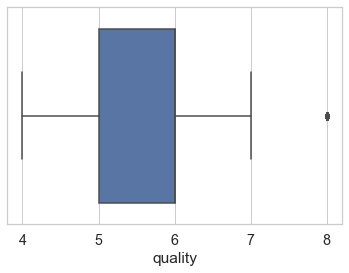

In [19]:
sns.boxplot(df_wine['quality'])                           # Plotting box plot for quality parameters

In [20]:
# To output pandas profiling report to an external html file.
# Saving the output as profiling_after_preprocessing.html

profile = df_wine.profile_report(title='Pandas Wine Profiling after Data Preprocessing')
profile.to_file(output_file="Wine profiling_after_preprocessing.html")

In [21]:
# To output the pandas profiling report on the notebook.

df_wine.profile_report(title='Pandas Wine Profiling after Data Preprocessing')

In [22]:
df_wine.head()                                

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
5,7.4,0.66,0.00,1.8,0.075,13.0,40.0,0.9978,3.51,0.56,9.4,5
6,7.9,0.60,0.06,1.6,0.069,15.0,59.0,0.9964,3.30,0.46,9.4,5
7,7.3,0.65,0.00,1.2,0.065,15.0,21.0,0.9946,3.39,0.47,10.0,7


Text(0.5, 1.0, 'Pie chart showing the proportion of different qualities')

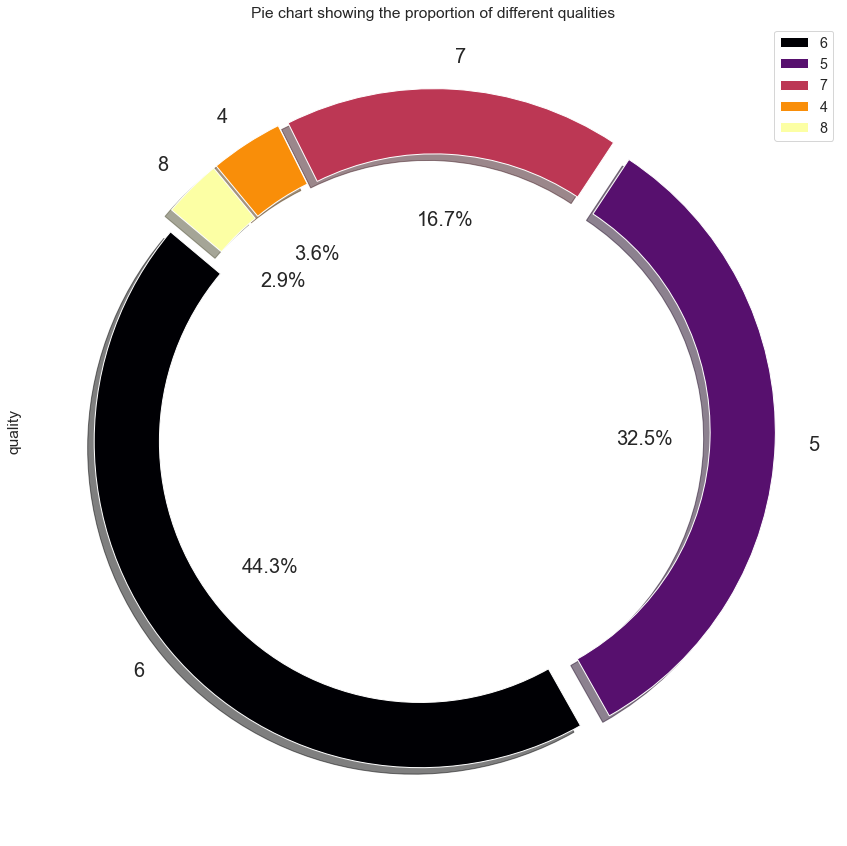

In [23]:
df_wine['quality'].value_counts().plot(kind='pie', explode=[0.05, 0.05, 0.05, 0.05, 0.05], fontsize=20, autopct='%3.1f%%', 
                                       figsize=(15,15), shadow=True, startangle=140, legend=True, cmap='inferno', wedgeprops={'width':0.2})

plt.ylabel('quality')
plt.title('Pie chart showing the proportion of different qualities')

<AxesSubplot:>

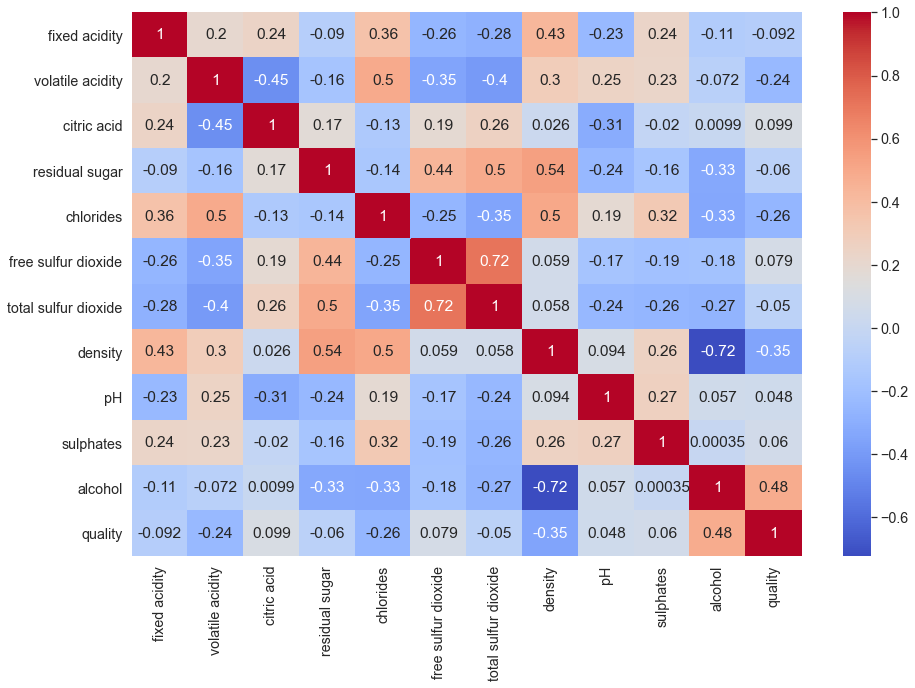

In [24]:
plt.subplots(figsize=(15, 10))
sns.heatmap(df_wine.corr(), annot = True, cmap = 'coolwarm')  # Plotting heatmap for showing correlation among all parameters

In [25]:
wine_parameters1 = ['free sulfur dioxide', 'total sulfur dioxide', 'quality']

IndexError: index 2 is out of bounds for axis 0 with size 2

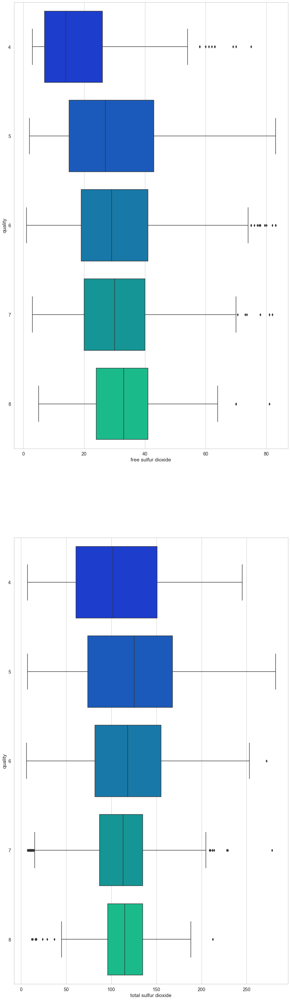

In [26]:
f, axes = plt.subplots(2, 1, figsize=(15,55))

for key, value in enumerate(wine_parameters1):      # Plotting 'free sulfur dioxide', 'total sulfur dioxide' against 'quality'
    sns.boxplot(data=df_wine, x=value, y='quality', orient='h', ax=axes[key], palette='winter')

In [27]:
wine_parameters2 = ['sulphates', 'citric acid', 'quality']

IndexError: index 2 is out of bounds for axis 0 with size 2

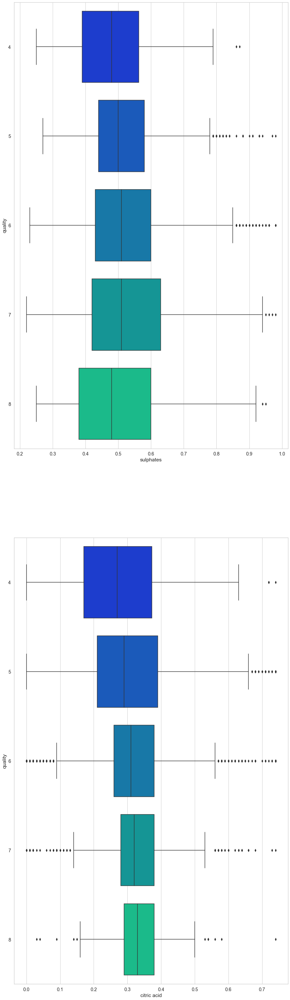

In [28]:
f, axes = plt.subplots(2, 1, figsize=(15,55))

for key, value in enumerate(wine_parameters2):    # Plotting 'sulphates', 'citric acid', against 'quality'
    sns.boxplot(data=df_wine, x=value, y='quality', orient='h', ax=axes[key], palette='winter')

In [29]:
wine_parameters3 = ['residual sugar', 'chlorides', 'quality']

IndexError: index 2 is out of bounds for axis 0 with size 2

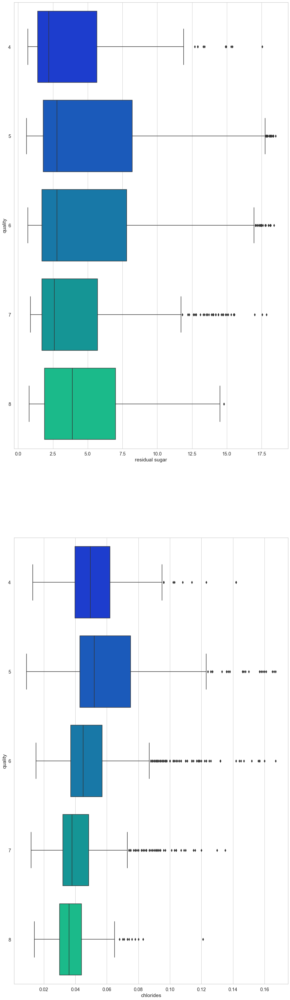

In [30]:
f, axes = plt.subplots(2, 1, figsize=(15,55))

for key, value in enumerate(wine_parameters3):         # Plotting 'residual sugar', 'chlorides', against 'quality'
    sns.boxplot(data=df_wine, x=value, y='quality', orient='h', ax=axes[key], palette='winter')

In [31]:
wine_parameters4 = ['fixed acidity', 'volatile acidity', 'quality']

IndexError: index 2 is out of bounds for axis 0 with size 2

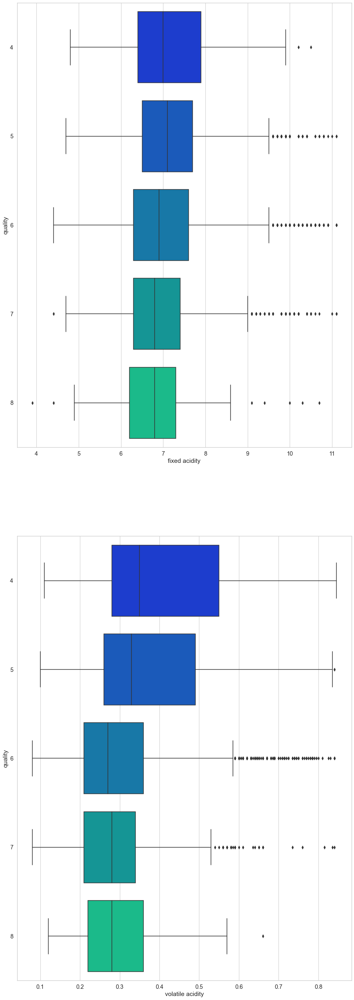

In [32]:
f, axes = plt.subplots(2, 1, figsize=(15,45))

for key, value in enumerate(wine_parameters4):          # Plotting 'fixed acidity', 'volatile acidity', against 'quality'
    sns.boxplot(data=df_wine, x=value, y='quality', orient='h', ax=axes[key], palette='winter')

In [33]:
wine_parameters5 = ['density', 'pH', 'quality']

IndexError: index 2 is out of bounds for axis 0 with size 2

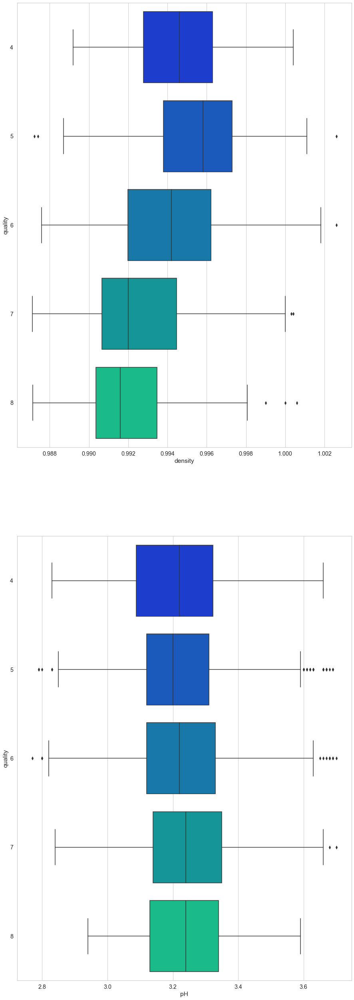

In [34]:
f, axes = plt.subplots(2, 1, figsize=(15,45))

for key, value in enumerate(wine_parameters5):        # Plotting 'density', 'pH', against 'quality'
    sns.boxplot(data=df_wine, x=value, y='quality', orient='h', ax=axes[key], palette='winter')

Text(0.5, 1.0, 'alochol vs quality')

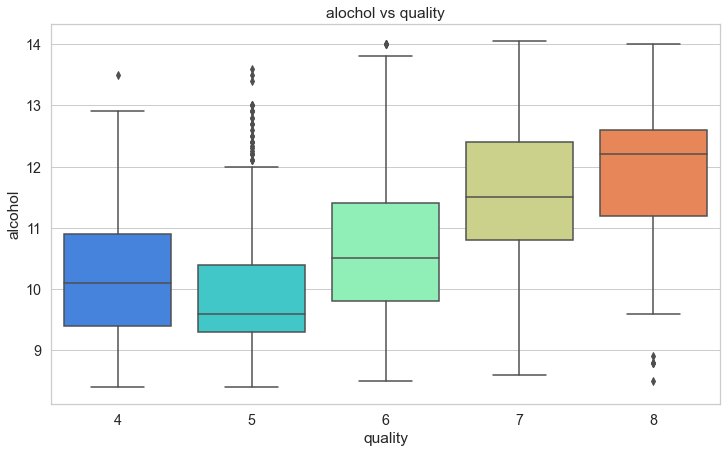

In [35]:
# Using seaborn's boxplot to plot a grouped boxplot of the Revenue and State columns.

plt.figure(figsize=(12,7))
sns.boxplot(data= df_wine, x='quality', y='alcohol', palette='rainbow')          # Plotting 'alcohol' against 'quality'

plt.title('alochol vs quality')

Text(0.5, 1.0, 'Histogram showing the distribution of alcohol values')

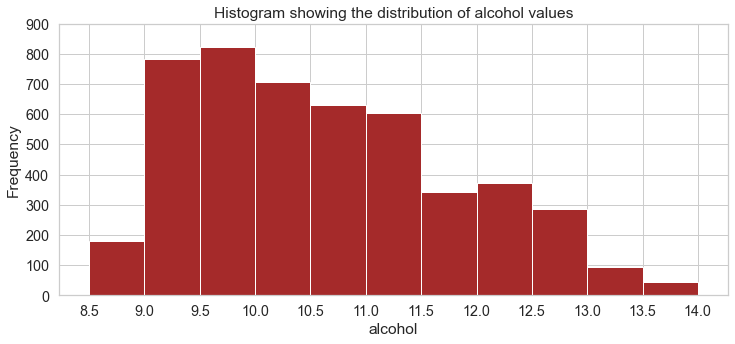

In [36]:
bins = [8.5,9,9.5,10,10.5,11,11.5,12,12.5,13,13.5,14,]
df_wine['alcohol'].plot(kind='hist', bins = bins, figsize=(12, 5), color='brown', yticks=np.arange(0, 1000, 100), xticks=bins)

plt.xlabel('alcohol')
plt.ylabel('Frequency')
plt.title('Histogram showing the distribution of alcohol values')